In [1]:
import numpy as np 
import pandas as pd 
import os
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torch.nn import Module, Sequential, Conv2d, ConvTranspose2d, LeakyReLU, BatchNorm2d, ReLU, Tanh, Sigmoid, BCELoss , AvgPool2d, Linear
import torchvision.utils as vutils

%matplotlib inline

In [2]:
dir_data = "/kaggle/input/procedural-environment-generation/dataset/dataset"
img_shape = (256,256,1)
img_paths = [dir_data + '/' + file for file in os.listdir(dir_data)]
img_paths = img_paths[:-6] #-6 because incomplete batch and -256 becuase last two iteration in an epoch causing some error

In [3]:
img_paths = np.sort(img_paths)

In [4]:
def load_images(img_paths):
    for image in img_paths:
        img = Image.open(image)
        img_array = np.array(img)
        img_array_normalized = (img_array - np.min(img_array)) / (np.max(img_array) - np.min(img_array))
        
        yield np.transpose(np.expand_dims(np.float32(img_array_normalized), axis = 2),(2,0,1))

In [5]:
def plot_images(imgs, grid_size = 5):

    fig = plt.figure(figsize = (6,6))
    plt.axis("off")
    columns = rows = grid_size
    plt.title("Training Images")
    images = load_images(imgs)
    for i in range(1, columns*rows +1):
        
        fig.add_subplot(rows, columns, i)
        plt.axis("off")
        plt.imshow(np.transpose(next(images), (1,2,0)), cmap = 'gray')
        
    plt.show()

In [6]:
images = load_images(img_paths)
image = next(images)

In [7]:
image.size

65536

In [8]:
dev = 'cuda:0' if torch.cuda.is_available() else 'cpu'
device = torch.device(dev)

In [9]:
device

device(type='cuda', index=0)

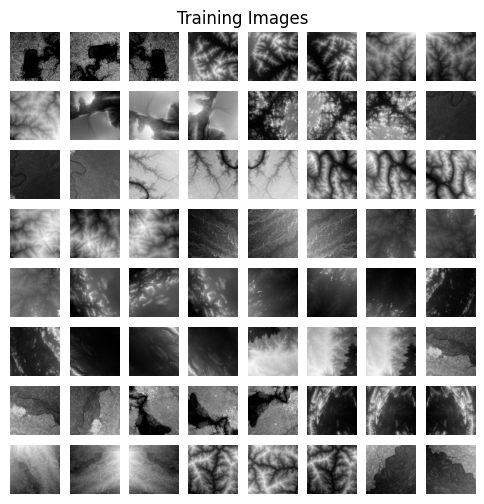

In [10]:
plot_images(img_paths, 8)

In [11]:
class Terrains(Dataset):
    def __init__(self, img_paths):
        '''np array containing all paths to all images'''
        self.img_paths = img_paths
    
    def __len__(self):
        return len(self.img_paths)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        image = next(load_images([self.img_paths[idx]]))
        return image

In [12]:
dset = Terrains(img_paths)
batch_size = 64
shuffle = True

In [13]:
dataloader = DataLoader(dataset = dset, batch_size = batch_size, shuffle = shuffle, num_workers = 2)

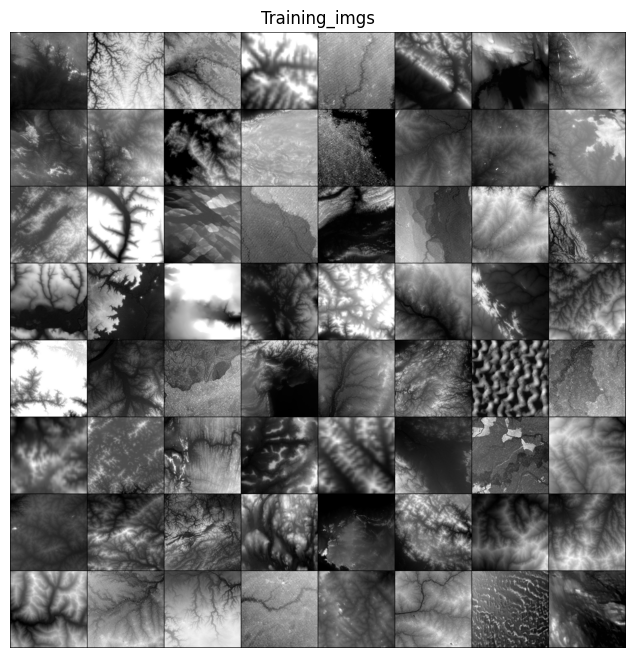

In [14]:
real_batch = next(iter(dataloader))
plt.figure(figsize = (8,8))
plt.axis("off")
plt.title("Training_imgs")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding = 2, normalize=True).cpu(),(1,2,0)), cmap='gray')
plt.show()

In [15]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [16]:
D_lr = 0.00005
G_lr = 0.00005
FILTER_SIZE = 8
BATCH_SIZE = 64

In [17]:
s = 256
s2, s4, s8 = int(s/2), int(s/4), int(s/8)
g_dim = 64
c_dim = 1

In [18]:
class Generator(Module):
    
    
    def __init__(self, batch_size, reuse = False):
        super().__init__()
               
        output2_shape = [batch_size, g_dim, s4 , s4 ]
        self.b_conv2 = nn.Parameter(torch.ones(output2_shape[1]) * 0.1)
        self.resize_layer2 = nn.Upsample(size=(output2_shape[2], output2_shape[3]), mode='nearest')
        self.conv2 = nn.Conv2d(in_channels=g_dim, out_channels=s4, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        self.batch_norm2 = nn.BatchNorm2d(s4)
        
        output3_shape = [batch_size,g_dim*2, s2 , s2 ]
        self.b_conv3 = nn.Parameter(torch.ones(output3_shape[1]) * 0.1)
        self.resize_layer3 = nn.Upsample(size=(output3_shape[2], output3_shape[3]), mode='nearest')
        self.conv3 = nn.Conv2d(in_channels=g_dim, out_channels=s8, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        self.batch_norm3 = nn.BatchNorm2d(s8)
        
        output4_shape = [batch_size, c_dim, s, s]
        self.b_conv4 = nn.Parameter(torch.ones(output4_shape[1]) * 0.1)
        self.resize_layer4 = nn.Upsample(size=(output4_shape[2], output4_shape[3]), mode='nearest')
        self.conv4 = nn.Conv2d(in_channels=s8, out_channels=1, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        
    def forward(self, z):
        
        h0 = torch.reshape(z, [batch_size//2, 64,s8,s8])
        h0 = LeakyReLU()(h0)
#         print(h0.shape)
        h_conv2 = self.resize_layer2(h0) + self.b_conv2
#         print(h_conv2.shape)
        h_conv2 = self.conv2(h_conv2)
#         print(h_conv2.shape)
        h_conv2 = LeakyReLU()(h_conv2)
        h_conv2 = self.batch_norm2(h_conv2)
        h_conv2 = LeakyReLU()(h_conv2)
        
        h_conv3 = self.resize_layer3(h_conv2) + self.b_conv3
#         print(h_conv3.shape)
        h_conv3 = self.conv3(h_conv3)
#         print(h_conv3.shape)
        h_conv3 = LeakyReLU()(h_conv3)
        h_conv3 = self.batch_norm3(h_conv3)
        h_conv3 = LeakyReLU()(h_conv3)
        
        h_conv4 = self.resize_layer4(h_conv3) + self.b_conv4
#         print(h_conv4.shape)
        h_conv4 = self.conv4(h_conv4)
#         print(h_conv4.shape)
        h_conv4 = LeakyReLU()(h_conv4)
        h_conv4 = Tanh()(h_conv4)
        
        return h_conv4

In [19]:
class Discriminator(Module):
    def __init__(self):
        super().__init__()
        self.leaky_relu = LeakyReLU()
        #256x256x1
        self.conv1 = Conv2d(in_channels=1, out_channels= 8 , kernel_size = 5, stride = 1, padding=1, bias = False)
        #leaky relu here
        #256x256x8
        self.pool1 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
        #128x128x8
        self.conv2 = Conv2d(in_channels=8, out_channels= 16 , kernel_size = 5, stride = 1, padding=1,  bias = False)
#         LeakyRelu here
        #128x128x16
        self.pool2 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
        #64x64x16
        #add flatten
        self.dimval = 64*64*16
        
        self.fc1 = Linear(self.dimval, 32,  bias = False)
#         LeakyReLU here
        self.fc2 = Linear(32, 1,  bias = False)
#         self.sigmoid = nn.Sigmoid()
        
    def forward(self, inputs):
#         print(inputs.shape)
        x = self.conv1(inputs)
#         print(x.shape)
        x = self.leaky_relu(x)
#         print(x.shape)
        x = self.pool1(x)
#         print(x.shape)
        x = self.conv2(x)
#         print(x.shape)
        x = self.leaky_relu(x)
#         print(x.shape)
        x = self.pool2(x)
#         print(x.shape)
        
        x = torch.reshape(x, [x.shape[0], self.dimval])
        
        x = self.fc1(x)
        x = self.leaky_relu(x)
        
        x =  self.fc2(x)
#         output = self.sigmoid(x)
        return x

In [20]:
ngpu = 2

In [21]:
BATCH_SIZE = 128

In [22]:
# Create the generator
netG = Generator(BATCH_SIZE).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

DataParallel(
  (module): Generator(
    (resize_layer2): Upsample(size=(64, 64), mode='nearest')
    (conv2): Conv2d(64, 64, kernel_size=(8, 8), stride=(1, 1), padding=same)
    (batch_norm2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (resize_layer3): Upsample(size=(128, 128), mode='nearest')
    (conv3): Conv2d(64, 32, kernel_size=(8, 8), stride=(1, 1), padding=same)
    (batch_norm3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (resize_layer4): Upsample(size=(256, 256), mode='nearest')
    (conv4): Conv2d(32, 1, kernel_size=(8, 8), stride=(1, 1), padding=same)
  )
)


In [23]:
netD = Discriminator().to(device)

# # Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

DataParallel(
  (module): Discriminator(
    (leaky_relu): LeakyReLU(negative_slope=0.01)
    (conv1): Conv2d(1, 8, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
    (pool1): AvgPool2d(kernel_size=2, stride=2, padding=1)
    (conv2): Conv2d(8, 16, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
    (pool2): AvgPool2d(kernel_size=2, stride=2, padding=1)
    (fc1): Linear(in_features=65536, out_features=32, bias=False)
    (fc2): Linear(in_features=32, out_features=1, bias=False)
  )
)


In [24]:
fixed_noise = torch.randn(batch_size, 256*256, 1,1,device = device)

In [25]:
real_label = 1
fake_label = 0

In [26]:
workers = 2
num_epochs = 20
beta1 = 0.5

In [27]:
optimizerD = optim.RMSprop(netD.parameters(), lr = D_lr)
optimizerG = optim.RMSprop(netG.parameters(), lr = G_lr)

In [28]:
device

device(type='cuda', index=0)

In [29]:
!mkdir checkpoints

Starting Training Loop...


/opt/conda/lib/python3.10/site-packages/torch/nn/modules/conv.py:456: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/Convolution.cpp:1008.)
  return F.conv2d(input, weight, bias, self.stride,


[1/20][0/1319]	Loss_D: -0.0028	Loss_G: -0.0000	D(x): 0.0026	D(G(z)): -0.0002 / 0.0000
[1/20][50/1319]	Loss_D: -0.2913	Loss_G: 0.4644	D(x): -0.1507	D(G(z)): -0.4420 / -0.4644
[1/20][100/1319]	Loss_D: -0.2659	Loss_G: 0.3054	D(x): -0.0533	D(G(z)): -0.3193 / -0.3054
[1/20][150/1319]	Loss_D: 0.0007	Loss_G: 0.2816	D(x): -0.2851	D(G(z)): -0.2844 / -0.2816
[1/20][200/1319]	Loss_D: -0.0160	Loss_G: 0.1893	D(x): -0.1607	D(G(z)): -0.1768 / -0.1893
[1/20][250/1319]	Loss_D: -0.0243	Loss_G: -0.0063	D(x): 0.0293	D(G(z)): 0.0050 / 0.0063
[1/20][300/1319]	Loss_D: -0.0723	Loss_G: 0.0457	D(x): 0.0569	D(G(z)): -0.0154 / -0.0457
[1/20][350/1319]	Loss_D: -0.0857	Loss_G: 0.0223	D(x): 0.0630	D(G(z)): -0.0227 / -0.0223
[1/20][400/1319]	Loss_D: -0.2095	Loss_G: 0.0406	D(x): 0.1910	D(G(z)): -0.0185 / -0.0406
[1/20][450/1319]	Loss_D: -0.1677	Loss_G: 0.0922	D(x): 0.0653	D(G(z)): -0.1024 / -0.0922
[1/20][500/1319]	Loss_D: -0.2680	Loss_G: 0.0492	D(x): 0.2455	D(G(z)): -0.0225 / -0.0492
[1/20][550/1319]	Loss_D: -0.2260	

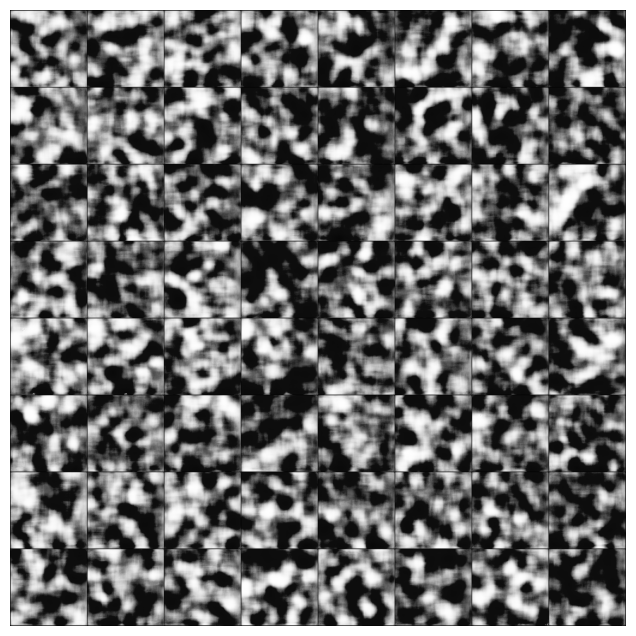

saved epoch 1
[2/20][0/1319]	Loss_D: -0.3563	Loss_G: 0.1733	D(x): 0.1183	D(G(z)): -0.2380 / -0.1733
[2/20][50/1319]	Loss_D: -0.1857	Loss_G: 0.1241	D(x): 0.1568	D(G(z)): -0.0289 / -0.1241
[2/20][100/1319]	Loss_D: -0.2324	Loss_G: 0.3239	D(x): -0.1195	D(G(z)): -0.3518 / -0.3239
[2/20][150/1319]	Loss_D: -0.2266	Loss_G: 0.1728	D(x): 0.0578	D(G(z)): -0.1688 / -0.1728
[2/20][200/1319]	Loss_D: -0.2161	Loss_G: 0.0250	D(x): 0.1725	D(G(z)): -0.0436 / -0.0250
[2/20][250/1319]	Loss_D: -0.2609	Loss_G: -0.1317	D(x): 0.3741	D(G(z)): 0.1132 / 0.1317
[2/20][300/1319]	Loss_D: -0.2547	Loss_G: -0.0855	D(x): 0.3407	D(G(z)): 0.0859 / 0.0855
[2/20][350/1319]	Loss_D: -0.0595	Loss_G: 0.1047	D(x): 0.0913	D(G(z)): 0.0318 / -0.1047
[2/20][400/1319]	Loss_D: -0.2288	Loss_G: 0.0355	D(x): 0.1897	D(G(z)): -0.0391 / -0.0355
[2/20][450/1319]	Loss_D: -0.1160	Loss_G: 0.0905	D(x): 0.1057	D(G(z)): -0.0103 / -0.0905
[2/20][500/1319]	Loss_D: -0.1898	Loss_G: 0.1409	D(x): 0.1298	D(G(z)): -0.0600 / -0.1409
[2/20][550/1319]	Loss_D

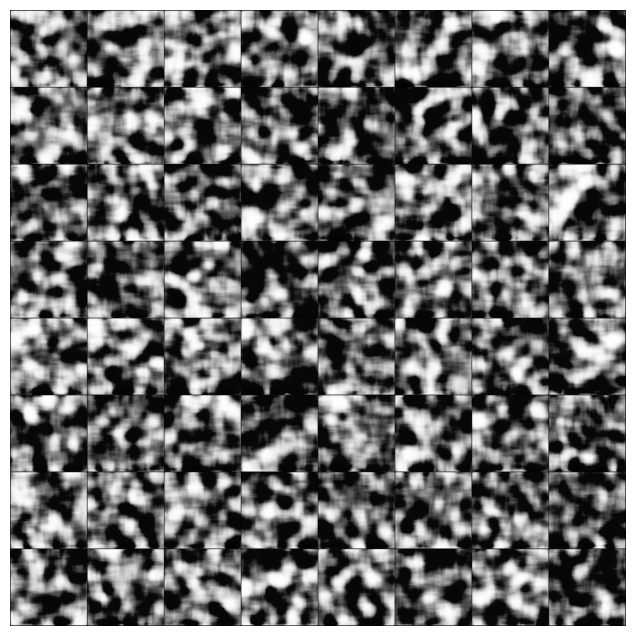

saved epoch 2
[3/20][0/1319]	Loss_D: -0.1428	Loss_G: -0.0167	D(x): 0.2510	D(G(z)): 0.1082 / 0.0167
[3/20][50/1319]	Loss_D: -0.3389	Loss_G: -0.0996	D(x): 0.4108	D(G(z)): 0.0720 / 0.0996
[3/20][100/1319]	Loss_D: -0.2645	Loss_G: -0.1653	D(x): 0.4593	D(G(z)): 0.1947 / 0.1653
[3/20][150/1319]	Loss_D: -0.1463	Loss_G: -0.0758	D(x): 0.2175	D(G(z)): 0.0712 / 0.0758
[3/20][200/1319]	Loss_D: -0.2214	Loss_G: -0.1777	D(x): 0.3796	D(G(z)): 0.1581 / 0.1777
[3/20][250/1319]	Loss_D: -0.1359	Loss_G: 0.0739	D(x): 0.1337	D(G(z)): -0.0022 / -0.0739
[3/20][300/1319]	Loss_D: -0.1476	Loss_G: 0.0486	D(x): 0.1794	D(G(z)): 0.0317 / -0.0486
[3/20][350/1319]	Loss_D: -0.2064	Loss_G: 0.1531	D(x): 0.0024	D(G(z)): -0.2040 / -0.1531
[3/20][400/1319]	Loss_D: -0.2429	Loss_G: -0.0133	D(x): 0.2261	D(G(z)): -0.0168 / 0.0133
[3/20][450/1319]	Loss_D: -0.1601	Loss_G: -0.0542	D(x): 0.2219	D(G(z)): 0.0617 / 0.0542
[3/20][500/1319]	Loss_D: -0.2083	Loss_G: 0.0693	D(x): 0.1805	D(G(z)): -0.0278 / -0.0693
[3/20][550/1319]	Loss_D: -0.

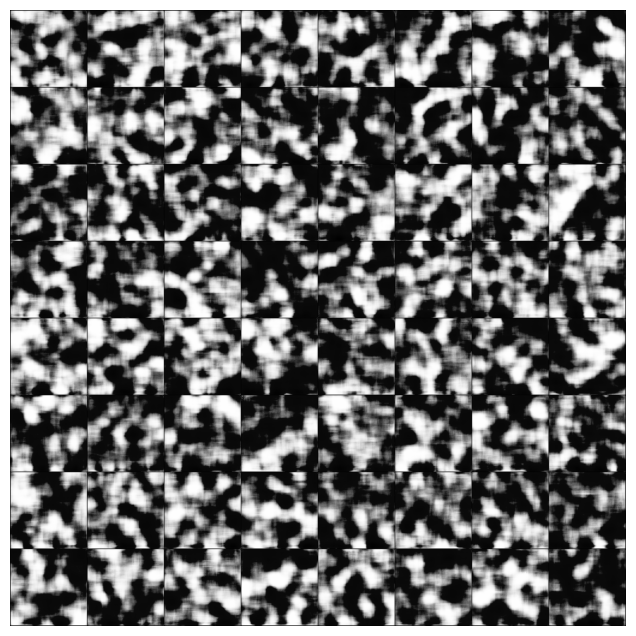

saved epoch 3
[4/20][0/1319]	Loss_D: -0.2365	Loss_G: 0.0378	D(x): 0.2181	D(G(z)): -0.0185 / -0.0378
[4/20][50/1319]	Loss_D: -0.2418	Loss_G: -0.0299	D(x): 0.2477	D(G(z)): 0.0059 / 0.0299
[4/20][100/1319]	Loss_D: -0.2731	Loss_G: -0.0849	D(x): 0.3777	D(G(z)): 0.1047 / 0.0849
[4/20][150/1319]	Loss_D: -0.3290	Loss_G: -0.0846	D(x): 0.3366	D(G(z)): 0.0076 / 0.0846
[4/20][200/1319]	Loss_D: -0.2803	Loss_G: -0.0993	D(x): 0.3785	D(G(z)): 0.0982 / 0.0993
[4/20][250/1319]	Loss_D: -0.3914	Loss_G: 0.0076	D(x): 0.4736	D(G(z)): 0.0822 / -0.0076
[4/20][300/1319]	Loss_D: -0.3355	Loss_G: 0.0857	D(x): 0.2559	D(G(z)): -0.0796 / -0.0857
[4/20][350/1319]	Loss_D: -0.2276	Loss_G: 0.3342	D(x): -0.0505	D(G(z)): -0.2781 / -0.3342
[4/20][400/1319]	Loss_D: -0.3224	Loss_G: -0.0326	D(x): 0.4451	D(G(z)): 0.1227 / 0.0326
[4/20][450/1319]	Loss_D: -0.3499	Loss_G: -0.1947	D(x): 0.5186	D(G(z)): 0.1688 / 0.1947
[4/20][500/1319]	Loss_D: -0.2872	Loss_G: -0.0816	D(x): 0.4694	D(G(z)): 0.1822 / 0.0816
[4/20][550/1319]	Loss_D: -0.

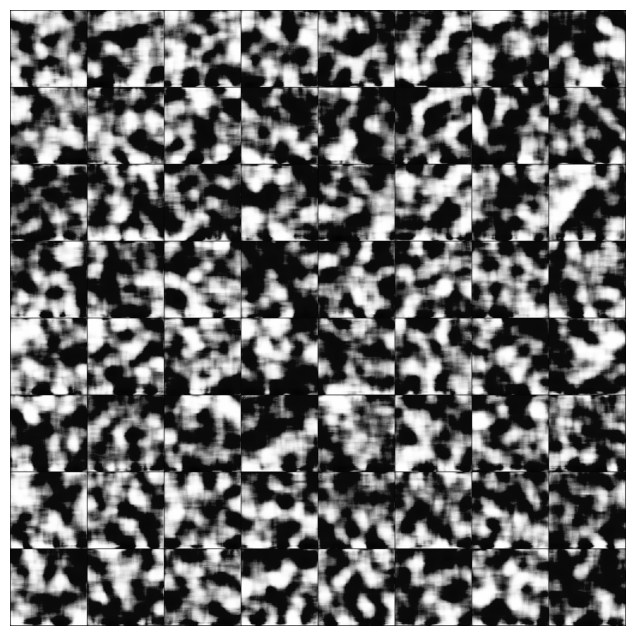

saved epoch 4
[5/20][0/1319]	Loss_D: -0.1815	Loss_G: 0.0235	D(x): 0.2130	D(G(z)): 0.0315 / -0.0235
[5/20][50/1319]	Loss_D: -0.3712	Loss_G: -0.1702	D(x): 0.6256	D(G(z)): 0.2544 / 0.1702
[5/20][100/1319]	Loss_D: -0.3859	Loss_G: -0.1518	D(x): 0.4791	D(G(z)): 0.0932 / 0.1518
[5/20][150/1319]	Loss_D: -0.4028	Loss_G: -0.1792	D(x): 0.5262	D(G(z)): 0.1235 / 0.1792
[5/20][200/1319]	Loss_D: -0.2820	Loss_G: -0.1106	D(x): 0.3223	D(G(z)): 0.0402 / 0.1106
[5/20][250/1319]	Loss_D: -0.0411	Loss_G: -0.0930	D(x): 0.3198	D(G(z)): 0.2787 / 0.0930
[5/20][300/1319]	Loss_D: -0.3923	Loss_G: -0.0444	D(x): 0.2885	D(G(z)): -0.1038 / 0.0444
[5/20][350/1319]	Loss_D: -0.2606	Loss_G: -0.2209	D(x): 0.6179	D(G(z)): 0.3573 / 0.2209
[5/20][400/1319]	Loss_D: -0.3010	Loss_G: 0.0628	D(x): 0.2898	D(G(z)): -0.0112 / -0.0628
[5/20][450/1319]	Loss_D: -0.2314	Loss_G: 0.0277	D(x): 0.4005	D(G(z)): 0.1691 / -0.0277
[5/20][500/1319]	Loss_D: -0.2549	Loss_G: -0.1407	D(x): 0.4925	D(G(z)): 0.2376 / 0.1407
[5/20][550/1319]	Loss_D: -0.40

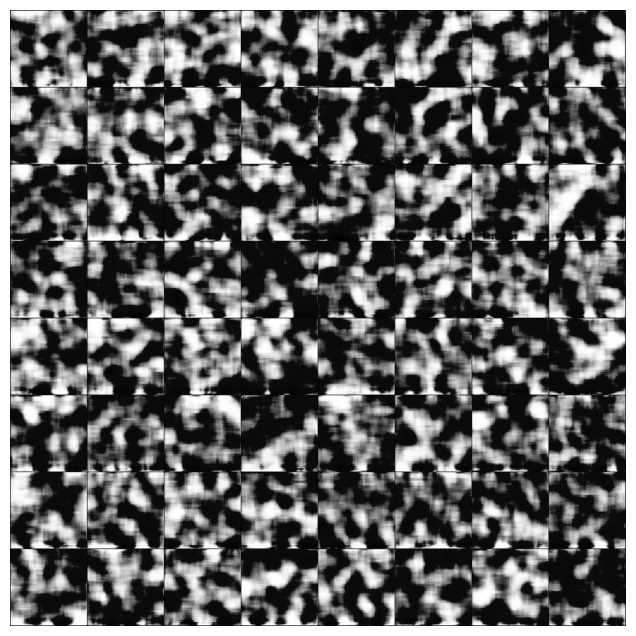

saved epoch 5
[6/20][0/1319]	Loss_D: -0.4493	Loss_G: -0.0106	D(x): 0.4344	D(G(z)): -0.0149 / 0.0106
[6/20][50/1319]	Loss_D: -0.3519	Loss_G: 0.0710	D(x): 0.4130	D(G(z)): 0.0611 / -0.0710
[6/20][100/1319]	Loss_D: -0.3908	Loss_G: 0.0866	D(x): 0.2465	D(G(z)): -0.1443 / -0.0866
[6/20][150/1319]	Loss_D: -0.3650	Loss_G: -0.2163	D(x): 0.5832	D(G(z)): 0.2182 / 0.2163
[6/20][200/1319]	Loss_D: -0.3883	Loss_G: 0.0068	D(x): 0.3286	D(G(z)): -0.0597 / -0.0068
[6/20][250/1319]	Loss_D: -0.5401	Loss_G: -0.1301	D(x): 0.6122	D(G(z)): 0.0721 / 0.1301
[6/20][300/1319]	Loss_D: -0.3664	Loss_G: -0.1139	D(x): 0.6198	D(G(z)): 0.2534 / 0.1139
[6/20][350/1319]	Loss_D: -0.2966	Loss_G: -0.1300	D(x): 0.5102	D(G(z)): 0.2136 / 0.1300
[6/20][400/1319]	Loss_D: -0.3590	Loss_G: -0.1251	D(x): 0.3199	D(G(z)): -0.0391 / 0.1251
[6/20][450/1319]	Loss_D: -0.1542	Loss_G: 0.0858	D(x): 0.2302	D(G(z)): 0.0760 / -0.0858
[6/20][500/1319]	Loss_D: -0.3830	Loss_G: 0.0306	D(x): 0.2634	D(G(z)): -0.1195 / -0.0306
[6/20][550/1319]	Loss_D: -0

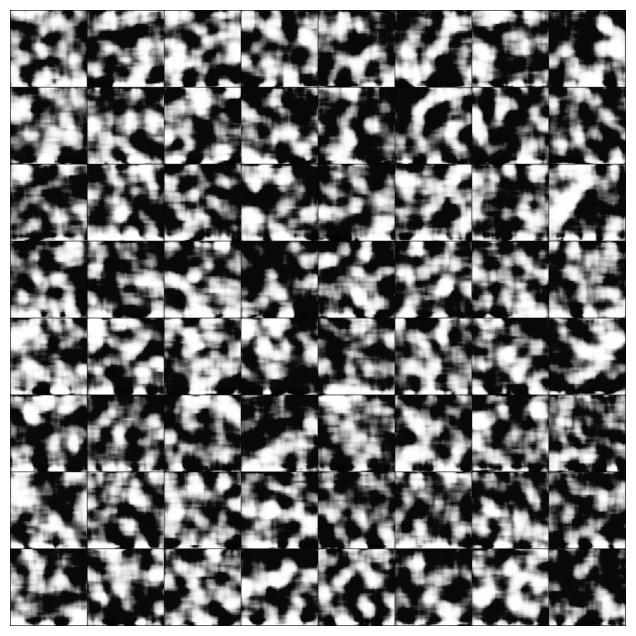

saved epoch 6
[7/20][0/1319]	Loss_D: -0.2643	Loss_G: 0.0660	D(x): 0.2598	D(G(z)): -0.0045 / -0.0660
[7/20][50/1319]	Loss_D: -0.2392	Loss_G: 0.0211	D(x): 0.2926	D(G(z)): 0.0534 / -0.0211
[7/20][100/1319]	Loss_D: -0.4668	Loss_G: 0.0371	D(x): 0.2649	D(G(z)): -0.2019 / -0.0371
[7/20][150/1319]	Loss_D: -0.2025	Loss_G: 0.2025	D(x): 0.1533	D(G(z)): -0.0492 / -0.2025
[7/20][200/1319]	Loss_D: -0.2689	Loss_G: 0.0046	D(x): 0.3384	D(G(z)): 0.0695 / -0.0046
[7/20][250/1319]	Loss_D: -0.3659	Loss_G: -0.1837	D(x): 0.5304	D(G(z)): 0.1645 / 0.1837
[7/20][300/1319]	Loss_D: -0.3040	Loss_G: -0.2783	D(x): 0.5389	D(G(z)): 0.2348 / 0.2783
[7/20][350/1319]	Loss_D: -0.3997	Loss_G: -0.0023	D(x): 0.3413	D(G(z)): -0.0584 / 0.0023
[7/20][400/1319]	Loss_D: -0.3475	Loss_G: -0.0763	D(x): 0.4378	D(G(z)): 0.0904 / 0.0763
[7/20][450/1319]	Loss_D: -0.3606	Loss_G: -0.1343	D(x): 0.3393	D(G(z)): -0.0213 / 0.1343
[7/20][500/1319]	Loss_D: -0.3231	Loss_G: -0.1245	D(x): 0.3550	D(G(z)): 0.0319 / 0.1245
[7/20][550/1319]	Loss_D: -0

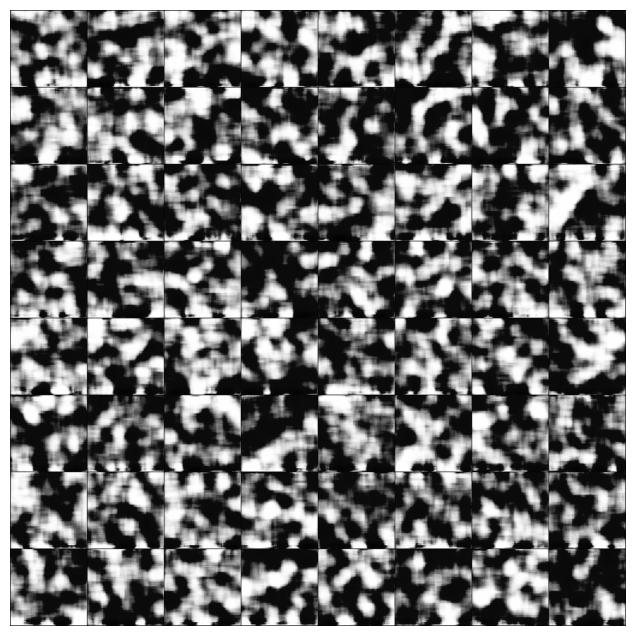

saved epoch 7
[8/20][0/1319]	Loss_D: -0.3712	Loss_G: -0.2436	D(x): 0.4269	D(G(z)): 0.0557 / 0.2436
[8/20][50/1319]	Loss_D: -0.2765	Loss_G: -0.2964	D(x): 0.5351	D(G(z)): 0.2587 / 0.2964
[8/20][100/1319]	Loss_D: -0.3577	Loss_G: 0.1113	D(x): 0.3003	D(G(z)): -0.0575 / -0.1113
[8/20][150/1319]	Loss_D: -0.4306	Loss_G: 0.1623	D(x): 0.3047	D(G(z)): -0.1259 / -0.1623
[8/20][200/1319]	Loss_D: -0.2602	Loss_G: -0.1866	D(x): 0.3309	D(G(z)): 0.0707 / 0.1866
[8/20][250/1319]	Loss_D: -0.2288	Loss_G: 0.1269	D(x): 0.1382	D(G(z)): -0.0906 / -0.1269
[8/20][300/1319]	Loss_D: -0.2549	Loss_G: 0.0417	D(x): 0.4421	D(G(z)): 0.1871 / -0.0417
[8/20][350/1319]	Loss_D: -0.4129	Loss_G: 0.0493	D(x): 0.3227	D(G(z)): -0.0902 / -0.0493
[8/20][400/1319]	Loss_D: -0.3734	Loss_G: -0.1175	D(x): 0.4059	D(G(z)): 0.0325 / 0.1175
[8/20][450/1319]	Loss_D: -0.2405	Loss_G: -0.0828	D(x): 0.3833	D(G(z)): 0.1428 / 0.0828
[8/20][500/1319]	Loss_D: -0.4549	Loss_G: 0.0664	D(x): 0.3098	D(G(z)): -0.1451 / -0.0664
[8/20][550/1319]	Loss_D: -0

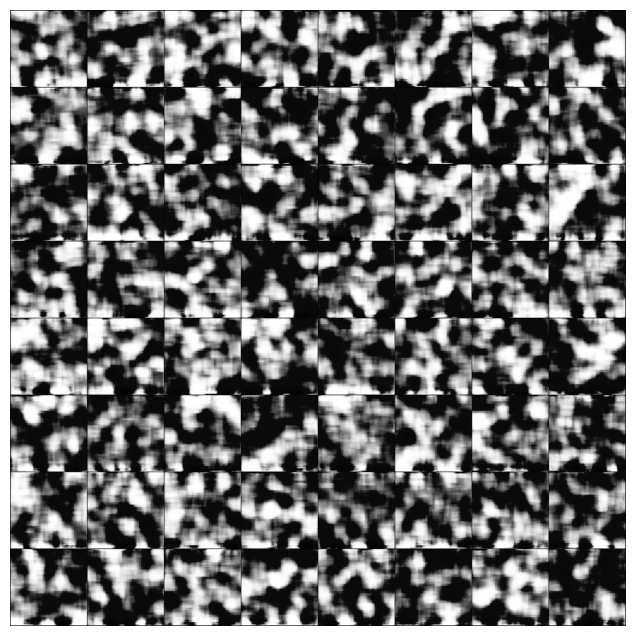

saved epoch 8
[9/20][0/1319]	Loss_D: -0.2939	Loss_G: 0.2051	D(x): 0.1261	D(G(z)): -0.1677 / -0.2051
[9/20][50/1319]	Loss_D: -0.4865	Loss_G: 0.0986	D(x): 0.3975	D(G(z)): -0.0889 / -0.0986
[9/20][100/1319]	Loss_D: -0.3377	Loss_G: -0.1648	D(x): 0.4557	D(G(z)): 0.1180 / 0.1648
[9/20][150/1319]	Loss_D: -0.5049	Loss_G: 0.2293	D(x): 0.1551	D(G(z)): -0.3498 / -0.2293
[9/20][200/1319]	Loss_D: -0.3997	Loss_G: 0.3099	D(x): 0.1332	D(G(z)): -0.2665 / -0.3099
[9/20][250/1319]	Loss_D: -0.2703	Loss_G: -0.2483	D(x): 0.5552	D(G(z)): 0.2849 / 0.2483
[9/20][300/1319]	Loss_D: -0.2960	Loss_G: 0.1323	D(x): 0.1750	D(G(z)): -0.1210 / -0.1323
[9/20][350/1319]	Loss_D: -0.3005	Loss_G: -0.0968	D(x): 0.3126	D(G(z)): 0.0121 / 0.0968
[9/20][400/1319]	Loss_D: -0.3056	Loss_G: 0.0201	D(x): 0.3169	D(G(z)): 0.0114 / -0.0201
[9/20][450/1319]	Loss_D: -0.3415	Loss_G: -0.1376	D(x): 0.3675	D(G(z)): 0.0260 / 0.1376
[9/20][500/1319]	Loss_D: -0.2381	Loss_G: 0.0050	D(x): 0.2765	D(G(z)): 0.0384 / -0.0050
[9/20][550/1319]	Loss_D: -0

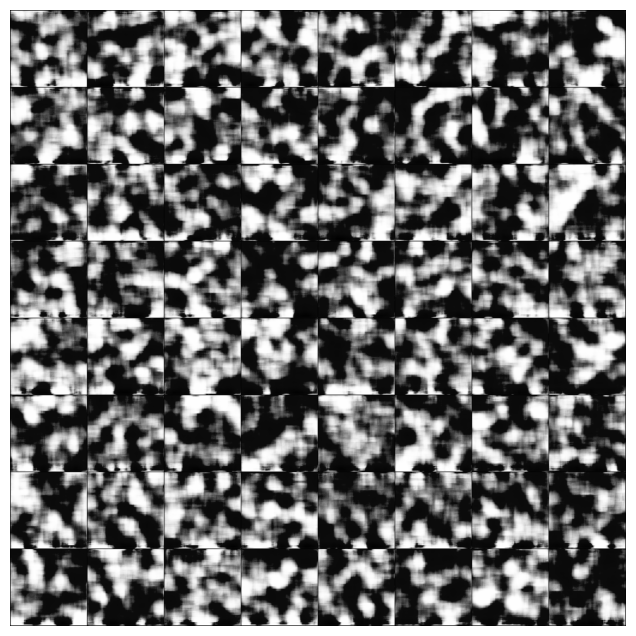

saved epoch 9
[10/20][0/1319]	Loss_D: -0.2966	Loss_G: 0.0648	D(x): 0.1970	D(G(z)): -0.0996 / -0.0648
[10/20][50/1319]	Loss_D: -0.3758	Loss_G: 0.1067	D(x): 0.3518	D(G(z)): -0.0241 / -0.1067
[10/20][100/1319]	Loss_D: -0.2973	Loss_G: 0.0690	D(x): 0.2060	D(G(z)): -0.0913 / -0.0690
[10/20][150/1319]	Loss_D: -0.1849	Loss_G: -0.1964	D(x): 0.5280	D(G(z)): 0.3431 / 0.1964
[10/20][200/1319]	Loss_D: -0.5494	Loss_G: 0.0461	D(x): 0.5430	D(G(z)): -0.0064 / -0.0461
[10/20][250/1319]	Loss_D: -0.2787	Loss_G: -0.0942	D(x): 0.2567	D(G(z)): -0.0220 / 0.0942
[10/20][300/1319]	Loss_D: -0.3004	Loss_G: 0.0104	D(x): 0.3783	D(G(z)): 0.0780 / -0.0104
[10/20][350/1319]	Loss_D: -0.2868	Loss_G: -0.1483	D(x): 0.2715	D(G(z)): -0.0152 / 0.1483
[10/20][400/1319]	Loss_D: -0.3233	Loss_G: -0.0257	D(x): 0.3994	D(G(z)): 0.0761 / 0.0257
[10/20][450/1319]	Loss_D: -0.2783	Loss_G: -0.2511	D(x): 0.5099	D(G(z)): 0.2316 / 0.2511
[10/20][500/1319]	Loss_D: -0.4371	Loss_G: 0.0817	D(x): 0.1620	D(G(z)): -0.2751 / -0.0817
[10/20][550/13

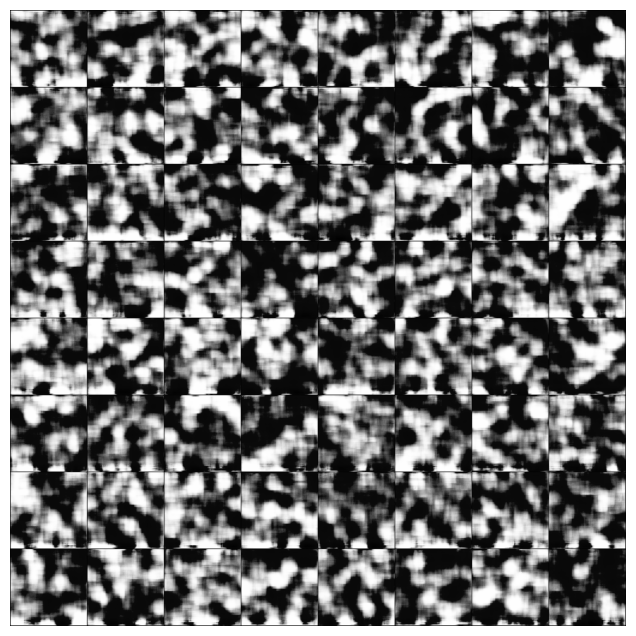

saved epoch 10
[11/20][0/1319]	Loss_D: -0.2066	Loss_G: -0.1819	D(x): 0.3107	D(G(z)): 0.1041 / 0.1819
[11/20][50/1319]	Loss_D: -0.3032	Loss_G: -0.3299	D(x): 0.3729	D(G(z)): 0.0696 / 0.3299
[11/20][100/1319]	Loss_D: -0.2700	Loss_G: 0.0230	D(x): 0.2918	D(G(z)): 0.0217 / -0.0230
[11/20][150/1319]	Loss_D: -0.4540	Loss_G: -0.3672	D(x): 0.8213	D(G(z)): 0.3673 / 0.3672
[11/20][200/1319]	Loss_D: -0.4144	Loss_G: -0.1546	D(x): 0.4795	D(G(z)): 0.0651 / 0.1546
[11/20][250/1319]	Loss_D: -0.3045	Loss_G: -0.0470	D(x): 0.3123	D(G(z)): 0.0077 / 0.0470
[11/20][300/1319]	Loss_D: -0.3726	Loss_G: 0.5580	D(x): 0.1278	D(G(z)): -0.2448 / -0.5580
[11/20][350/1319]	Loss_D: -0.1519	Loss_G: 0.1528	D(x): 0.0990	D(G(z)): -0.0529 / -0.1528
[11/20][400/1319]	Loss_D: -0.1466	Loss_G: 0.1696	D(x): -0.0488	D(G(z)): -0.1954 / -0.1696
[11/20][450/1319]	Loss_D: -0.2097	Loss_G: 0.1697	D(x): 0.1330	D(G(z)): -0.0767 / -0.1697
[11/20][500/1319]	Loss_D: -0.1717	Loss_G: 0.1009	D(x): 0.0963	D(G(z)): -0.0754 / -0.1009
[11/20][550/13

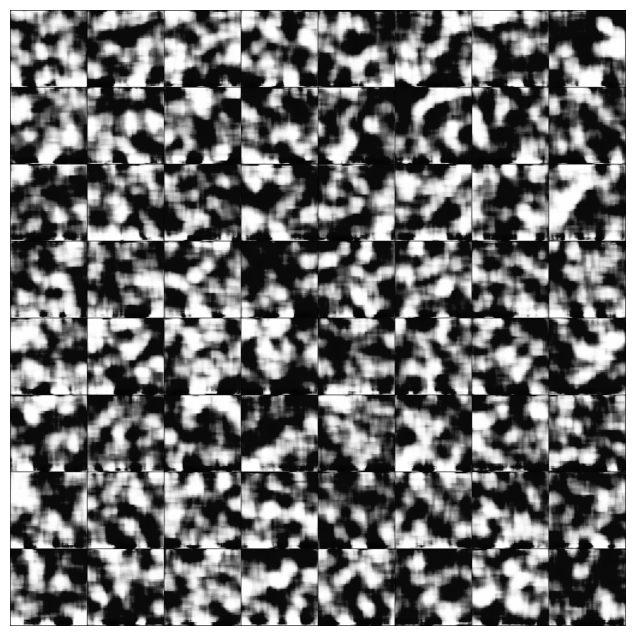

saved epoch 11
[12/20][0/1319]	Loss_D: -0.5191	Loss_G: -0.1647	D(x): 0.5659	D(G(z)): 0.0468 / 0.1647
[12/20][50/1319]	Loss_D: -0.3616	Loss_G: -0.2478	D(x): 0.4839	D(G(z)): 0.1223 / 0.2478
[12/20][100/1319]	Loss_D: -0.3004	Loss_G: 0.1651	D(x): 0.1674	D(G(z)): -0.1330 / -0.1651
[12/20][150/1319]	Loss_D: -0.2616	Loss_G: 0.0141	D(x): 0.1758	D(G(z)): -0.0858 / -0.0141
[12/20][200/1319]	Loss_D: -0.3435	Loss_G: 0.1196	D(x): 0.2263	D(G(z)): -0.1172 / -0.1196
[12/20][250/1319]	Loss_D: -0.2456	Loss_G: 0.2423	D(x): 0.0036	D(G(z)): -0.2420 / -0.2423
[12/20][300/1319]	Loss_D: -0.2975	Loss_G: -0.0897	D(x): 0.4102	D(G(z)): 0.1127 / 0.0897
[12/20][350/1319]	Loss_D: -0.1949	Loss_G: -0.0419	D(x): 0.1862	D(G(z)): -0.0088 / 0.0419
[12/20][400/1319]	Loss_D: -0.5791	Loss_G: 0.0968	D(x): 0.3512	D(G(z)): -0.2279 / -0.0968
[12/20][450/1319]	Loss_D: -0.4023	Loss_G: -0.3080	D(x): 0.7010	D(G(z)): 0.2987 / 0.3080
[12/20][500/1319]	Loss_D: -0.1155	Loss_G: 0.0953	D(x): 0.1305	D(G(z)): 0.0151 / -0.0953
[12/20][550/13

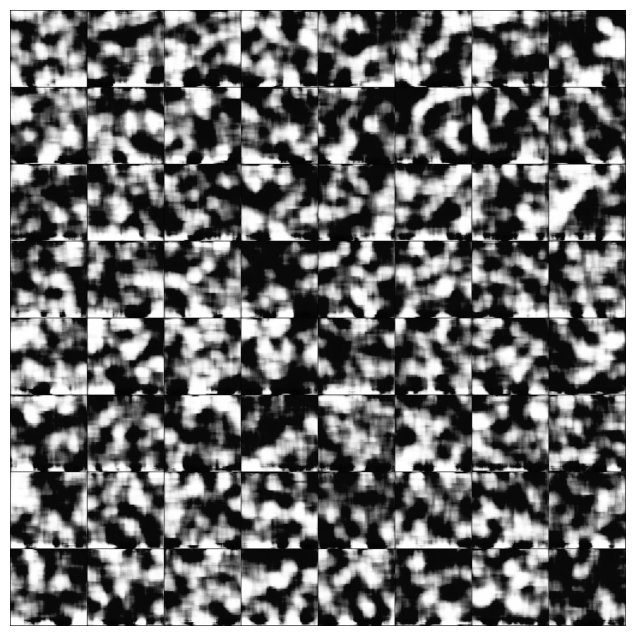

saved epoch 12
[13/20][0/1319]	Loss_D: -0.2447	Loss_G: -0.1952	D(x): 0.4709	D(G(z)): 0.2262 / 0.1952
[13/20][50/1319]	Loss_D: -0.3844	Loss_G: 0.0798	D(x): 0.2122	D(G(z)): -0.1722 / -0.0798
[13/20][100/1319]	Loss_D: -0.4661	Loss_G: 0.1682	D(x): 0.3574	D(G(z)): -0.1087 / -0.1682
[13/20][150/1319]	Loss_D: -0.3449	Loss_G: -0.0383	D(x): 0.4586	D(G(z)): 0.1138 / 0.0383
[13/20][200/1319]	Loss_D: -0.4996	Loss_G: -0.0940	D(x): 0.5327	D(G(z)): 0.0331 / 0.0940
[13/20][250/1319]	Loss_D: -0.2674	Loss_G: -0.0210	D(x): 0.2067	D(G(z)): -0.0607 / 0.0210
[13/20][300/1319]	Loss_D: -0.4570	Loss_G: -0.0312	D(x): 0.3465	D(G(z)): -0.1105 / 0.0312
[13/20][350/1319]	Loss_D: -0.3868	Loss_G: -0.3140	D(x): 0.6510	D(G(z)): 0.2642 / 0.3140
[13/20][400/1319]	Loss_D: -0.3978	Loss_G: -0.0817	D(x): 0.4158	D(G(z)): 0.0180 / 0.0817
[13/20][450/1319]	Loss_D: -0.2973	Loss_G: -0.1574	D(x): 0.3158	D(G(z)): 0.0185 / 0.1574
[13/20][500/1319]	Loss_D: -0.2007	Loss_G: 0.2798	D(x): 0.1281	D(G(z)): -0.0726 / -0.2798
[13/20][550/131

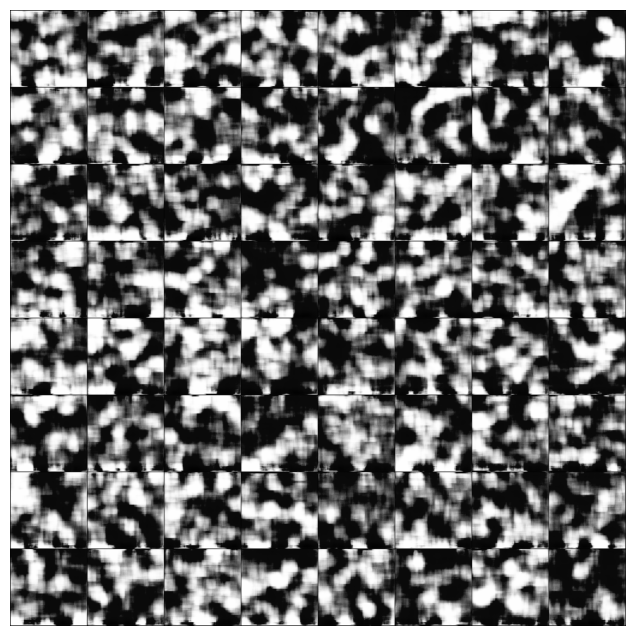

saved epoch 13
[14/20][0/1319]	Loss_D: -0.1819	Loss_G: -0.2296	D(x): 0.4460	D(G(z)): 0.2641 / 0.2296
[14/20][50/1319]	Loss_D: -0.2686	Loss_G: -0.0258	D(x): 0.3557	D(G(z)): 0.0871 / 0.0258
[14/20][100/1319]	Loss_D: -0.3484	Loss_G: 0.0432	D(x): 0.4796	D(G(z)): 0.1312 / -0.0432
[14/20][150/1319]	Loss_D: -0.3855	Loss_G: -0.0244	D(x): 0.3662	D(G(z)): -0.0193 / 0.0244
[14/20][200/1319]	Loss_D: -0.3051	Loss_G: 0.0261	D(x): 0.2481	D(G(z)): -0.0570 / -0.0261
[14/20][250/1319]	Loss_D: -0.4285	Loss_G: 0.1851	D(x): 0.1895	D(G(z)): -0.2390 / -0.1851
[14/20][300/1319]	Loss_D: -0.3973	Loss_G: -0.0225	D(x): 0.3999	D(G(z)): 0.0027 / 0.0225
[14/20][350/1319]	Loss_D: -0.3857	Loss_G: -0.2042	D(x): 0.5603	D(G(z)): 0.1746 / 0.2042
[14/20][400/1319]	Loss_D: -0.3743	Loss_G: 0.1536	D(x): 0.2282	D(G(z)): -0.1461 / -0.1536
[14/20][450/1319]	Loss_D: -0.3138	Loss_G: -0.0022	D(x): 0.1473	D(G(z)): -0.1664 / 0.0022
[14/20][500/1319]	Loss_D: -0.4299	Loss_G: -0.4468	D(x): 0.7112	D(G(z)): 0.2813 / 0.4468
[14/20][550/131

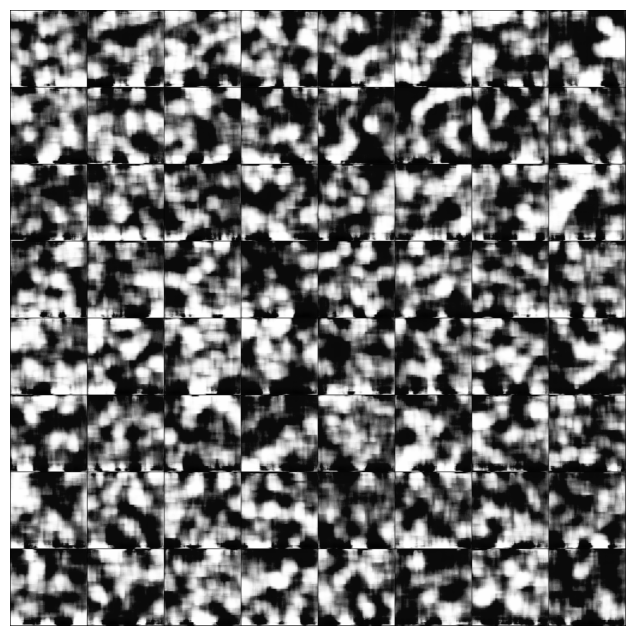

saved epoch 14
[15/20][0/1319]	Loss_D: -0.3256	Loss_G: -0.0764	D(x): 0.4030	D(G(z)): 0.0774 / 0.0764
[15/20][50/1319]	Loss_D: -0.4425	Loss_G: -0.1227	D(x): 0.5401	D(G(z)): 0.0976 / 0.1227
[15/20][100/1319]	Loss_D: -0.0873	Loss_G: 0.1067	D(x): 0.2203	D(G(z)): 0.1330 / -0.1067
[15/20][150/1319]	Loss_D: -0.1607	Loss_G: 0.1508	D(x): 0.1683	D(G(z)): 0.0077 / -0.1508
[15/20][200/1319]	Loss_D: -0.2971	Loss_G: 0.0908	D(x): 0.1551	D(G(z)): -0.1420 / -0.0908
[15/20][250/1319]	Loss_D: -0.2661	Loss_G: -0.0554	D(x): 0.3482	D(G(z)): 0.0821 / 0.0554
[15/20][300/1319]	Loss_D: -0.1505	Loss_G: -0.0088	D(x): 0.3847	D(G(z)): 0.2342 / 0.0088
[15/20][350/1319]	Loss_D: -0.2482	Loss_G: -0.1311	D(x): 0.3723	D(G(z)): 0.1241 / 0.1311
[15/20][400/1319]	Loss_D: -0.2087	Loss_G: -0.1869	D(x): 0.4316	D(G(z)): 0.2229 / 0.1869
[15/20][450/1319]	Loss_D: -0.3192	Loss_G: 0.1982	D(x): 0.1941	D(G(z)): -0.1251 / -0.1982
[15/20][500/1319]	Loss_D: -0.1424	Loss_G: 0.2073	D(x): 0.2590	D(G(z)): 0.1167 / -0.2073
[15/20][550/1319]	

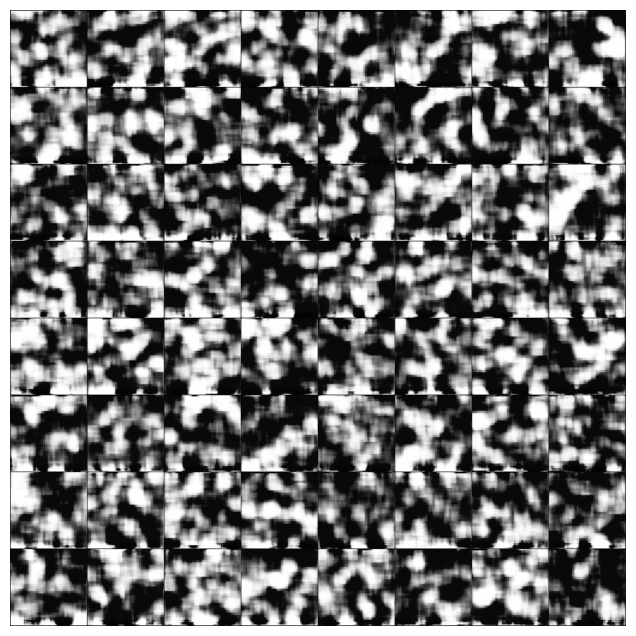

saved epoch 15
[16/20][0/1319]	Loss_D: -0.2891	Loss_G: -0.0867	D(x): 0.3320	D(G(z)): 0.0429 / 0.0867
[16/20][50/1319]	Loss_D: -0.3195	Loss_G: -0.1087	D(x): 0.3977	D(G(z)): 0.0782 / 0.1087
[16/20][100/1319]	Loss_D: -0.5268	Loss_G: -0.0928	D(x): 0.5470	D(G(z)): 0.0202 / 0.0928
[16/20][150/1319]	Loss_D: -0.3628	Loss_G: 0.3323	D(x): 0.2086	D(G(z)): -0.1543 / -0.3323
[16/20][200/1319]	Loss_D: -0.4524	Loss_G: 0.0679	D(x): 0.2720	D(G(z)): -0.1804 / -0.0679
[16/20][250/1319]	Loss_D: -0.3440	Loss_G: 0.0750	D(x): 0.3356	D(G(z)): -0.0084 / -0.0750
[16/20][300/1319]	Loss_D: -0.3445	Loss_G: -0.1490	D(x): 0.3044	D(G(z)): -0.0402 / 0.1490
[16/20][350/1319]	Loss_D: -0.2913	Loss_G: 0.0797	D(x): 0.3152	D(G(z)): 0.0238 / -0.0797
[16/20][400/1319]	Loss_D: -0.3347	Loss_G: 0.0860	D(x): 0.2426	D(G(z)): -0.0921 / -0.0860
[16/20][450/1319]	Loss_D: -0.2954	Loss_G: -0.1827	D(x): 0.3365	D(G(z)): 0.0411 / 0.1827
[16/20][500/1319]	Loss_D: -0.2942	Loss_G: 0.0700	D(x): 0.3054	D(G(z)): 0.0111 / -0.0700
[16/20][550/131

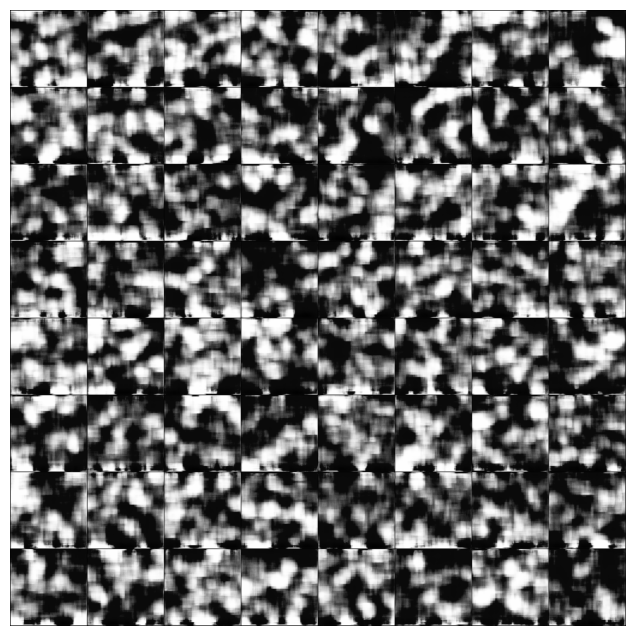

saved epoch 16
[17/20][0/1319]	Loss_D: -0.3674	Loss_G: -0.0850	D(x): 0.5271	D(G(z)): 0.1597 / 0.0850
[17/20][50/1319]	Loss_D: -0.1406	Loss_G: 0.0453	D(x): 0.1295	D(G(z)): -0.0112 / -0.0453
[17/20][100/1319]	Loss_D: -0.3700	Loss_G: -0.3237	D(x): 0.6233	D(G(z)): 0.2533 / 0.3237
[17/20][150/1319]	Loss_D: -0.3573	Loss_G: 0.1964	D(x): 0.2517	D(G(z)): -0.1055 / -0.1964
[17/20][200/1319]	Loss_D: -0.3901	Loss_G: -0.1313	D(x): 0.5403	D(G(z)): 0.1502 / 0.1313
[17/20][250/1319]	Loss_D: -0.3115	Loss_G: -0.2235	D(x): 0.3862	D(G(z)): 0.0747 / 0.2235
[17/20][300/1319]	Loss_D: -0.3243	Loss_G: 0.0143	D(x): 0.2815	D(G(z)): -0.0428 / -0.0143
[17/20][350/1319]	Loss_D: -0.3577	Loss_G: -0.1328	D(x): 0.4272	D(G(z)): 0.0695 / 0.1328
[17/20][400/1319]	Loss_D: -0.3585	Loss_G: -0.1906	D(x): 0.4340	D(G(z)): 0.0755 / 0.1906
[17/20][450/1319]	Loss_D: -0.2477	Loss_G: -0.1535	D(x): 0.4306	D(G(z)): 0.1829 / 0.1535
[17/20][500/1319]	Loss_D: -0.3559	Loss_G: -0.2430	D(x): 0.4878	D(G(z)): 0.1319 / 0.2430
[17/20][550/1319]

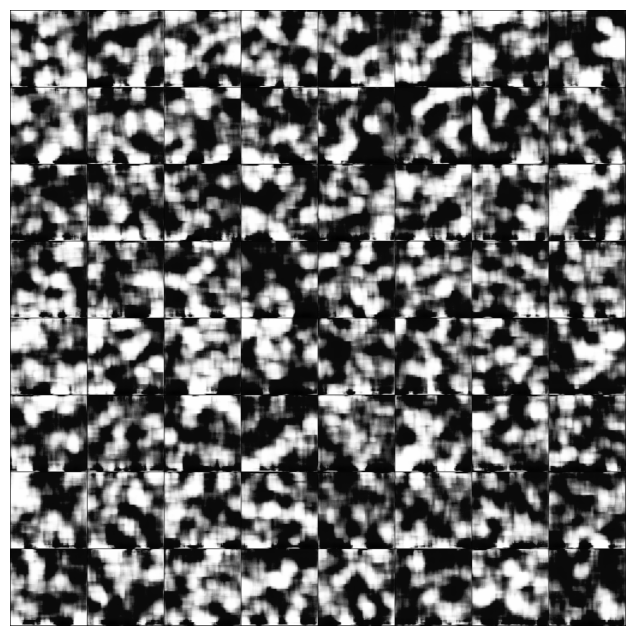

saved epoch 17
[18/20][0/1319]	Loss_D: -0.3791	Loss_G: 0.0529	D(x): 0.2795	D(G(z)): -0.0997 / -0.0529
[18/20][50/1319]	Loss_D: -0.2912	Loss_G: -0.0785	D(x): 0.2919	D(G(z)): 0.0007 / 0.0785
[18/20][100/1319]	Loss_D: -0.3067	Loss_G: 0.1003	D(x): 0.2945	D(G(z)): -0.0122 / -0.1003
[18/20][150/1319]	Loss_D: -0.1632	Loss_G: -0.2321	D(x): 0.3635	D(G(z)): 0.2003 / 0.2321
[18/20][200/1319]	Loss_D: -0.4381	Loss_G: -0.2029	D(x): 0.5035	D(G(z)): 0.0654 / 0.2029
[18/20][250/1319]	Loss_D: -0.2748	Loss_G: -0.0086	D(x): 0.4139	D(G(z)): 0.1390 / 0.0086
[18/20][300/1319]	Loss_D: -0.2353	Loss_G: -0.1905	D(x): 0.3493	D(G(z)): 0.1140 / 0.1905
[18/20][350/1319]	Loss_D: -0.2832	Loss_G: 0.1522	D(x): 0.1916	D(G(z)): -0.0916 / -0.1522
[18/20][400/1319]	Loss_D: -0.3919	Loss_G: -0.1440	D(x): 0.4454	D(G(z)): 0.0535 / 0.1440
[18/20][450/1319]	Loss_D: -0.1285	Loss_G: 0.2140	D(x): 0.0331	D(G(z)): -0.0953 / -0.2140
[18/20][500/1319]	Loss_D: -0.1915	Loss_G: -0.1938	D(x): 0.5027	D(G(z)): 0.3112 / 0.1938
[18/20][550/1319

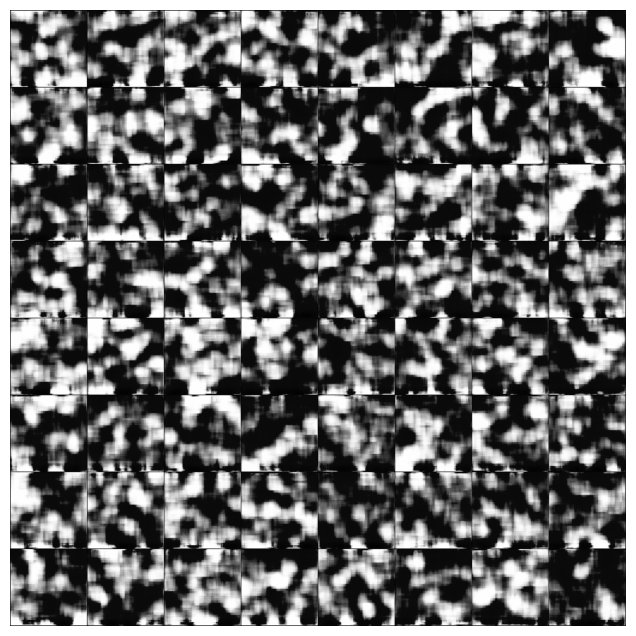

saved epoch 18
[19/20][0/1319]	Loss_D: -0.1949	Loss_G: 0.1879	D(x): 0.1404	D(G(z)): -0.0545 / -0.1879
[19/20][50/1319]	Loss_D: -0.3643	Loss_G: -0.2116	D(x): 0.4817	D(G(z)): 0.1174 / 0.2116
[19/20][100/1319]	Loss_D: -0.3880	Loss_G: -0.2566	D(x): 0.4047	D(G(z)): 0.0166 / 0.2566
[19/20][150/1319]	Loss_D: -0.3729	Loss_G: -0.0580	D(x): 0.4613	D(G(z)): 0.0883 / 0.0580
[19/20][200/1319]	Loss_D: -0.2445	Loss_G: -0.0577	D(x): 0.3335	D(G(z)): 0.0890 / 0.0577
[19/20][250/1319]	Loss_D: -0.1142	Loss_G: 0.0014	D(x): 0.3218	D(G(z)): 0.2075 / -0.0014
[19/20][300/1319]	Loss_D: -0.2878	Loss_G: 0.2275	D(x): 0.1707	D(G(z)): -0.1172 / -0.2275
[19/20][350/1319]	Loss_D: -0.3583	Loss_G: -0.2547	D(x): 0.5589	D(G(z)): 0.2006 / 0.2547
[19/20][400/1319]	Loss_D: -0.2874	Loss_G: -0.0646	D(x): 0.3073	D(G(z)): 0.0199 / 0.0646
[19/20][450/1319]	Loss_D: -0.2204	Loss_G: -0.1506	D(x): 0.2599	D(G(z)): 0.0395 / 0.1506
[19/20][500/1319]	Loss_D: -0.2930	Loss_G: 0.1336	D(x): 0.2377	D(G(z)): -0.0552 / -0.1336
[19/20][550/1319]

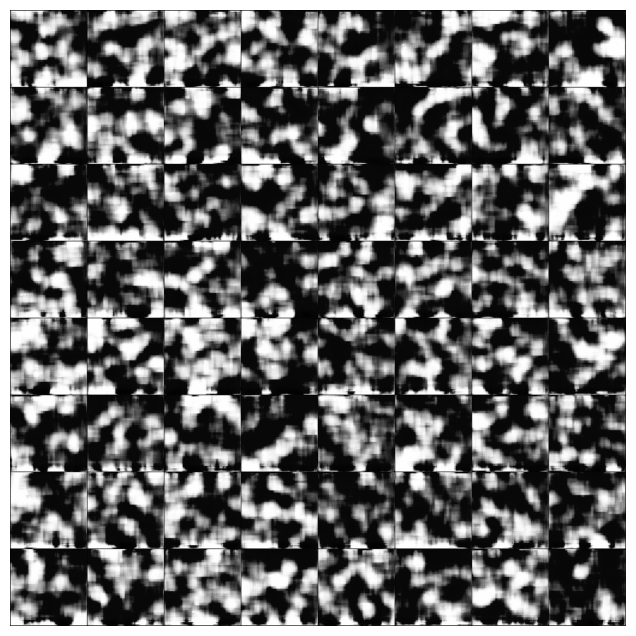

saved epoch 19
[20/20][0/1319]	Loss_D: -0.2858	Loss_G: -0.1478	D(x): 0.2839	D(G(z)): -0.0019 / 0.1478
[20/20][50/1319]	Loss_D: -0.3687	Loss_G: 0.0940	D(x): 0.1916	D(G(z)): -0.1771 / -0.0940
[20/20][100/1319]	Loss_D: -0.3507	Loss_G: 0.4825	D(x): -0.1988	D(G(z)): -0.5495 / -0.4825
[20/20][150/1319]	Loss_D: -0.2419	Loss_G: -0.0619	D(x): 0.2560	D(G(z)): 0.0140 / 0.0619
[20/20][200/1319]	Loss_D: -0.3121	Loss_G: 0.2360	D(x): 0.0711	D(G(z)): -0.2410 / -0.2360
[20/20][250/1319]	Loss_D: -0.3666	Loss_G: 0.0462	D(x): 0.3329	D(G(z)): -0.0337 / -0.0462
[20/20][300/1319]	Loss_D: -0.2908	Loss_G: -0.2669	D(x): 0.4728	D(G(z)): 0.1820 / 0.2669
[20/20][350/1319]	Loss_D: -0.2297	Loss_G: 0.0314	D(x): 0.3191	D(G(z)): 0.0894 / -0.0314
[20/20][400/1319]	Loss_D: -0.3361	Loss_G: 0.2546	D(x): 0.1887	D(G(z)): -0.1474 / -0.2546
[20/20][450/1319]	Loss_D: -0.2924	Loss_G: 0.0010	D(x): 0.3661	D(G(z)): 0.0737 / -0.0010
[20/20][500/1319]	Loss_D: -0.2884	Loss_G: 0.1677	D(x): 0.2698	D(G(z)): -0.0185 / -0.1677
[20/20][550/

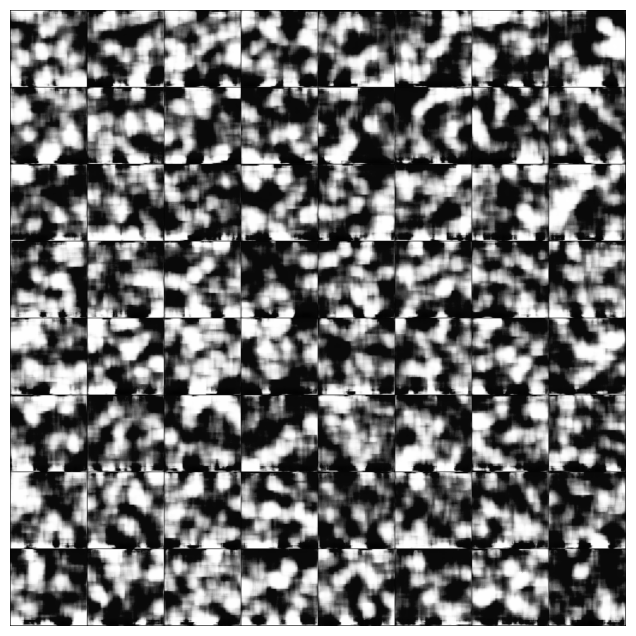

saved epoch 20


In [30]:
img_list = []
G_losses = []
D_losses = []
D_real_losses = []
D_fake_losses = []
iters = 0

print("Starting Training Loop...")

for epoch in range(1,num_epochs+1):
    for i, data in enumerate(dataloader, 0):
        for _ in range (5):
            ##train with all reals
            netD.zero_grad()
            #setup batch
            real_cpu = data.to(device)
            b_size = real_cpu.size(0)
    #         label = torch.full((b_size,1), real_label, dtype=torch.float, device = device)

            #fwd pass thru D
            output = netD(real_cpu)
            errD_real = -torch.mean(output)
            D_x = output.mean().item()
            ##train with all fakes
            #gen batch of latent

            noise = torch.randn(b_size, 256*256,1,1, device = device)
            #generate fake batch by G
            fake = netG(noise)
            output = netD(fake.detach())
            D_G_z1 = output.mean().item()
            errD_fake = torch.mean(output)
            #compute errD as sum of fake and real
            errD = errD_fake + errD_real

            #update D
            errD.backward()
            optimizerD.step()
            
            with torch.no_grad():
                for w in netD.parameters():
                    w.clamp_(-0.01,0.01)

        
        ############################
        # (2) Update G network
        ###########################
        
        netG.zero_grad()
#         label.fill_(real_label)# fake labels are real for generator cost
        noise = torch.randn(b_size, 256*256,1,1, device = device)
        fake = netG(noise)
        output = netD(fake)
        errG = -torch.mean(output)
#         print(errG)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        if i%50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        D_real_losses.append(errD_real.item())
        D_fake_losses.append(errD_fake.item())
        
    print(f"EPOCH_{epoch} OUTPUT")
    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
    fig = plt.figure(figsize=(8,8))
    plt.axis("off")
    ims = [[ plt.imshow(np.transpose(i,(1,2,0)), cmap = 'gray')]for i in img_list]
    plt.show()

    img_list = []
        
    
    PATH = f"/kaggle/working/checkpoints/{epoch}_GAN.pt"
    torch.save({

        'Gen_state_dict': netG.state_dict(),
        'Disc_state_dict': netD.state_dict(),
        'optimizerG_state_dict': optimizerG.state_dict(),
        'optimizerD_state_dict': optimizerD.state_dict(),
    }, PATH)
    print(f"saved epoch {epoch}")
    iters += 1
PATH = f"/kaggle/working/checkpoints/last_GAN.pt"
torch.save({

    'Gen_state_dict': netG.state_dict(),
    'Disc_state_dict': netD.state_dict(),
    'optimizerG_state_dict': optimizerG.state_dict(),
    'optimizerD_state_dict': optimizerD.state_dict(),
}, PATH)

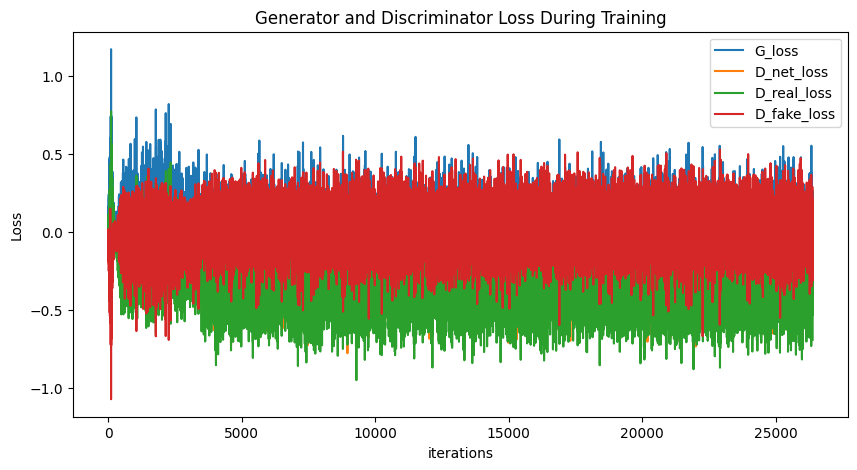

In [31]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G_loss")
plt.plot(D_losses,label="D_net_loss")
plt.plot(D_real_losses, label = "D_real_loss")
plt.plot(D_fake_losses, label = "D_fake_loss")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig("Losses graph.png")
plt.show()

In [32]:
!zip -r checkpoints.zip /kaggle/working/checkpoints

  adding: kaggle/working/checkpoints/ (stored 0%)
  adding: kaggle/working/checkpoints/2_GAN.pt (deflated 20%)
  adding: kaggle/working/checkpoints/12_GAN.pt (deflated 24%)
  adding: kaggle/working/checkpoints/14_GAN.pt (deflated 26%)
  adding: kaggle/working/checkpoints/20_GAN.pt (deflated 27%)
  adding: kaggle/working/checkpoints/16_GAN.pt (deflated 25%)
  adding: kaggle/working/checkpoints/17_GAN.pt (deflated 25%)
  adding: kaggle/working/checkpoints/3_GAN.pt (deflated 24%)
  adding: kaggle/working/checkpoints/8_GAN.pt (deflated 27%)
  adding: kaggle/working/checkpoints/5_GAN.pt (deflated 23%)
  adding: kaggle/working/checkpoints/19_GAN.pt (deflated 23%)
  adding: kaggle/working/checkpoints/11_GAN.pt (deflated 28%)
  adding: kaggle/working/checkpoints/1_GAN.pt (deflated 21%)
  adding: kaggle/working/checkpoints/6_GAN.pt (deflated 24%)
  adding: kaggle/working/checkpoints/13_GAN.pt (deflated 26%)
  adding: kaggle/working/checkpoints/9_GAN.pt (deflated 25%)
  adding: kaggle/working/ch

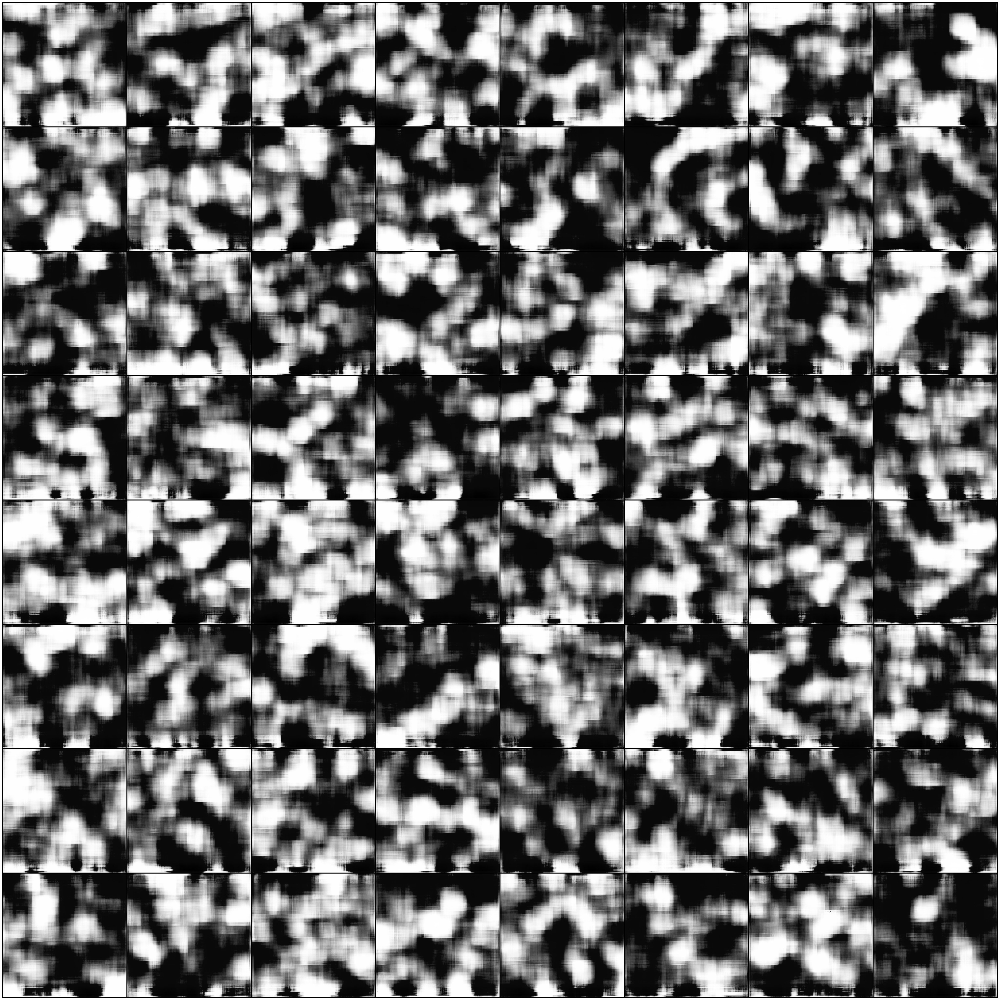

In [33]:
img_list = []
with torch.no_grad():
    fake = netG(fixed_noise).detach().cpu()
img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
fig = plt.figure(figsize=(64,64))
plt.axis("off")
ims = [[ plt.imshow(np.transpose(i,(1,2,0)), cmap = 'gray')]for i in img_list]
plt.show()

In [34]:
!mkdir losses

In [35]:
import pickle
with open('/kaggle/working/losses/G_losses.pkl', 'wb') as f:
    pickle.dump(G_losses, f)

with open('/kaggle/working/losses/D_losses.pkl', 'wb') as f:
    pickle.dump(D_losses, f)

with open('/kaggle/working/losses/D_real_losses.pkl', 'wb') as f:
    pickle.dump(D_real_losses, f)
    
with open('/kaggle/working/losses/D_fake_losses.pkl', 'wb') as f:
    pickle.dump(D_fake_losses, f)

In [36]:
!zip -r losses.zip /kaggle/working/losses

  adding: kaggle/working/losses/ (stored 0%)
  adding: kaggle/working/losses/D_fake_losses.pkl (deflated 49%)
  adding: kaggle/working/losses/D_real_losses.pkl (deflated 52%)
  adding: kaggle/working/losses/D_losses.pkl (deflated 53%)
  adding: kaggle/working/losses/G_losses.pkl (deflated 49%)
